Code for out of domain approximation of a function.

Fixed True Coefficients: [-1.08284929  0.41939221  1.00211126 -3.70079986  2.26857464 -4.16072086
 -0.61470381  3.15940724 -4.90486339 -3.79202795 -2.27861577 -3.90860086
 -3.08252684 -0.13484517 -4.13143698  4.56970951 -2.43911203  5.87766555
  5.97071535  2.82850091 -7.43396103]


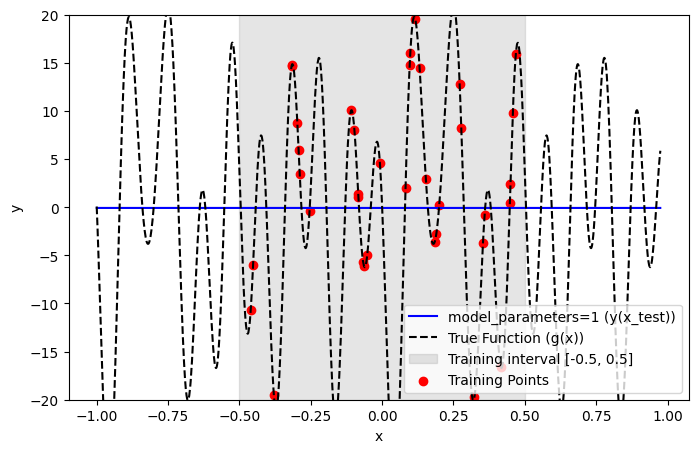

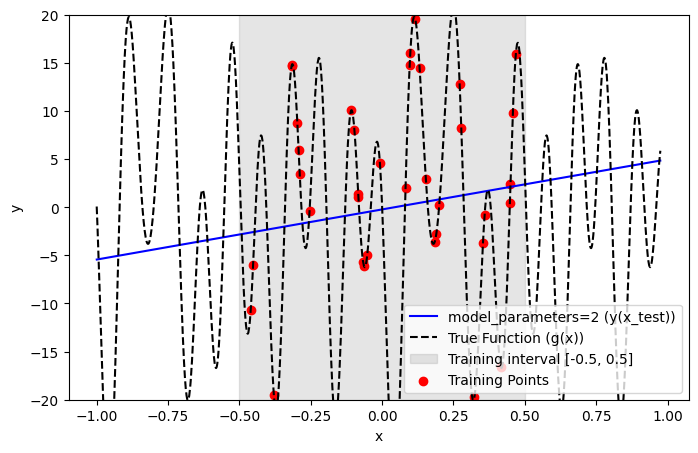

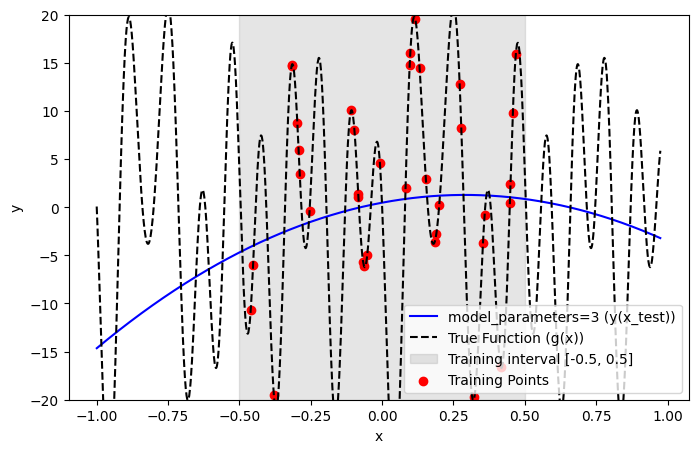

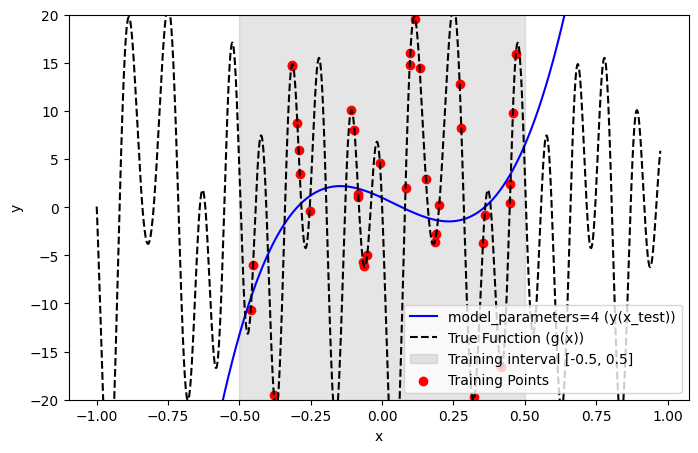

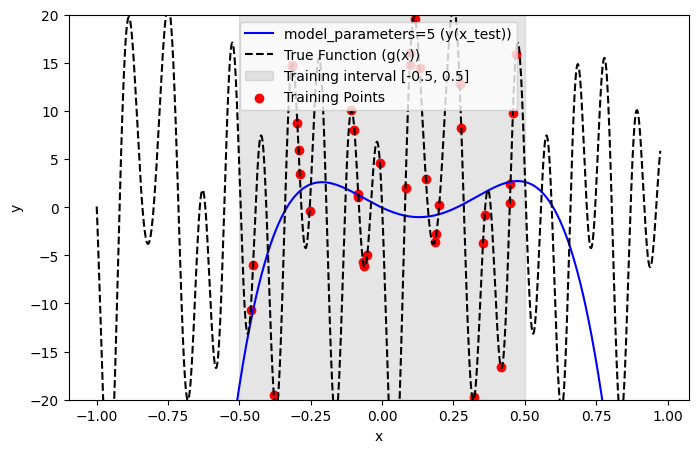

...

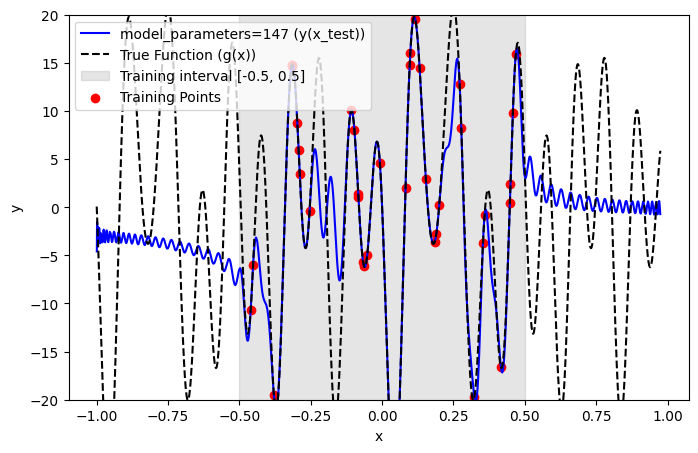

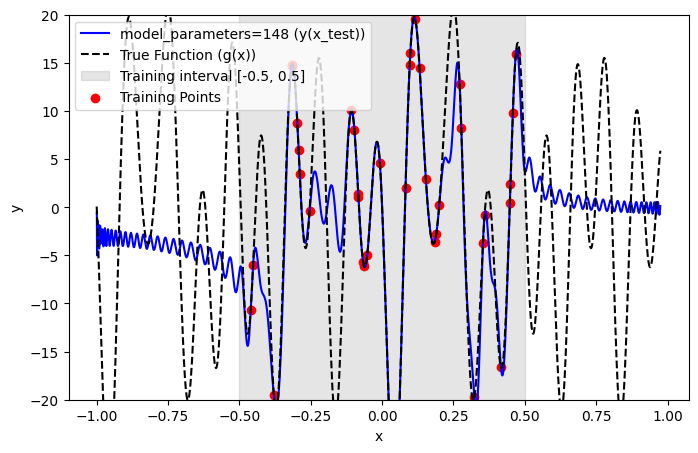

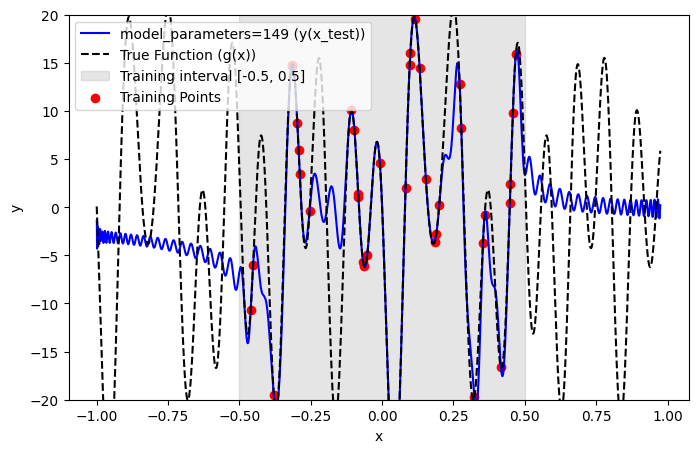

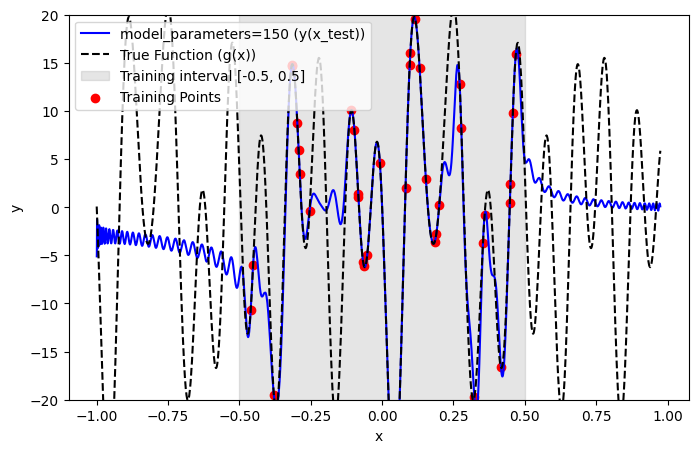

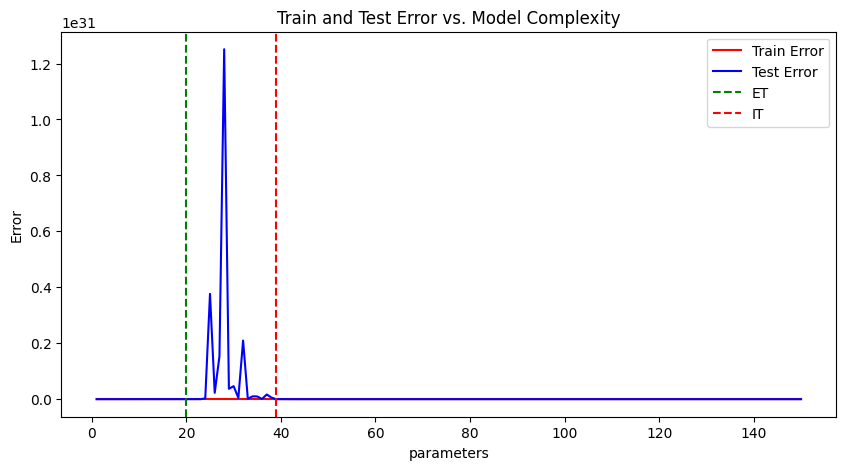

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import scipy.special as sp

# Fixed random seed for reproducibility
np.random.seed(41)

# Decide the values of the variables
n =40
n_test = 3500
f_max = 10
d_true = 2 * f_max + 1  # Use f_max if you are using Fourier basis otherwise input directly
d_model_max = 150   # Maximum value for d_model
in_low = -0.5
in_high = 0.5 #- (1 / n)
out_low = -1.0
out_high = 1.0 - (1 / n)
noise_mean = 0.0
noise_std = 0.0
data_basis_type = "fourier"  # Fourier, Legendre, Chebyshev, Bernstein
train_basis_type = "legendre" # Fourier, Legendre, Chebyshev, Bernstein
test_basis_type = "legendre"  # Fourier, Legendre, Chebyshev, Bernstein
Sampling_type = "random"

# Generate fixed true coefficients
#c_true = np.random.randn(d_true)
sigma = 4.0
mu = 0.0
c_true = np.random.randn(d_true) * sigma + mu  # Mean = mu, Std dev = sigma

print("Fixed True Coefficients:", c_true)

# Function to generate x values based on sampling type
def generate_x(n, low, high, sampling_type):
    if sampling_type == "uniform":
        x = np.linspace(low, high, n)
    elif sampling_type == "random":
        x = np.random.uniform(low, high, n)
        x = np.sort(x)
    #elif sampling_type == "chebyshev_nodes":
        #x = np.cos((2 * np.arange(1, n + 1) - 1) / (2 * n) * np.pi)
    elif sampling_type == "chebyshev_nodes":
        # Generate Chebyshev nodes on the interval [-1, 1]
        x = np.cos((2 * np.arange(1, n + 1) - 1) / (2 * n) * np.pi)
        # Scale Chebyshev nodes to the interval [low, high]
        x = 0.5 * (x + 1) * (high - low) + low
    elif sampling_type == "legendre_nodes":
        x, _ = np.polynomial.legendre.leggauss(n)  # Legendre-Gauss nodes
        x = 0.5 * (x + 1) * (high - low) + low
    elif sampling_type == "hermite_nodes":
        x, _ = np.polynomial.hermite.hermgauss(n)  # Hermite-Gauss nodes
    else:
        raise ValueError("Invalid sampling type")
    return x

# Function to generate design matrix based on basis type
def design_matrix(x, d, basis_type):
    x = np.asarray(x).reshape(-1, 1)
    n = len(x)
    X = np.ones((n, d))

    if basis_type == 'fourier':
        for k in range(1, d // 2 + 1):
            X[:, 2 * k - 1] = np.cos(2 * np.pi * k * x[:, 0])
            if 2 * k < d:
                X[:, 2 * k] = np.sin(2 * np.pi * k * x[:, 0])
    elif basis_type == 'monomial':
        for k in range(0, d):
            X[:, k] = x[:, 0] ** k
    elif basis_type == 'legendre':
        for k in range(0, d):
            X[:, k] = sp.legendre(k)(x[:, 0])
    elif basis_type == 'hermite':
        for k in range(0, d):
            X[:, k] = sp.hermite(k)(x[:, 0])
    elif basis_type == 'chebyshev':
        for k in range(0, d):
            X[:, k] = sp.chebyt(k)(x[:, 0])
    elif basis_type == 'bernstein':
        #x_scaled = (x - np.min(x)) / (np.max(x) - np.min(x))  # Rescale to [0,1]
        x_scaled = x
        for k in range(d):
            X[:, k] = sp.comb(d - 1, k) * (x_scaled[:, 0] ** k) * ((1 - x_scaled[:, 0]) ** (d - 1 - k))
    else:
        raise ValueError("Unsupported basis type. Choose from 'fourier', 'monomial', 'legendre', 'hermite', 'chebyshev', or 'bernstein'.")

    return X

# Generate true function values
x_true = generate_x(4000, out_low, out_high, Sampling_type)
phi_true = design_matrix(x_true, d_true, data_basis_type)
y_true = phi_true.dot(c_true)

# Generate training data
x_train = generate_x(n, in_low, in_high, Sampling_type)
phi_train = design_matrix(x_train, d_true, data_basis_type)
noise = np.random.normal(noise_mean, noise_std, n)
y_train = phi_train.dot(c_true) + noise

# Generate test data without noise
x_test = generate_x(n_test, out_low, out_high, Sampling_type)
phi_test = design_matrix(x_test, d_true, data_basis_type)
y_test = phi_test.dot(c_true)

# Store errors and R² scores
train_errors = []
test_errors = []
train_nrmse_errors = []
test_nrmse_errors = []

for d_model in range(1, d_model_max + 1):
    phi_train_model = design_matrix(x_train, d_model, train_basis_type)
    c_opt = np.linalg.pinv(phi_train_model, rcond=1e-38) @ y_train
    # Compute train prediction
    y_train_pred = phi_train_model @ c_opt

    # Compute test predictions
    phi_test_model = design_matrix(x_test, d_model, test_basis_type)
    y_test_pred = phi_test_model @ c_opt

    # Compute errors
    train_error = np.mean((y_train - y_train_pred) ** 2)
    test_error = np.mean((y_test - y_test_pred) ** 2)
    train_errors.append(train_error)
    test_errors.append(test_error)

    # Compute RMSE
    train_rmse = np.sqrt(train_error)
    test_rmse = np.sqrt(test_error)
    train_nrmse_errors.append(train_rmse / (np.max(y_train) - np.min(y_train)))
    test_nrmse_errors.append(test_rmse / (np.max(y_test) - np.min(y_test)))

    # Plot fits separately
    plt.figure(figsize=(8, 5))
    plt.plot(x_test, y_test_pred, label=f'model_parameters={d_model} (y(x_test))', color='blue')
    plt.plot(x_true, y_true, label='True Function (g(x))', color='black', linestyle='dashed')
    plt.axvspan(in_low, in_high, color='gray', alpha=0.2, label=f'Training interval [{in_low}, {in_high}]')
    plt.ylim(bottom=-20,top=20)
    plt.scatter(x_train, y_train, color='red', label='Training Points')
    plt.legend()
    plt.xlabel("x")
    plt.ylabel("y")
    #plt.title(f"Model Fit for model_parameters={d_model}")
    plt.show()

# Plot errors
plt.figure(figsize=(10, 5))
plt.plot(range(1, d_model_max + 1), train_errors, label='Train Error', color='red')
plt.plot(range(1, d_model_max + 1), test_errors, label='Test Error', color='blue')
plt.axvline(x=d_true-1, color='green', linestyle='--', label='ET')
plt.axvline(x=n-1, color='red', linestyle='--', label='IT')
plt.xlabel("parameters")
plt.ylabel("Error")
plt.legend()
plt.title("Train and Test Error vs. Model Complexity")
plt.show()


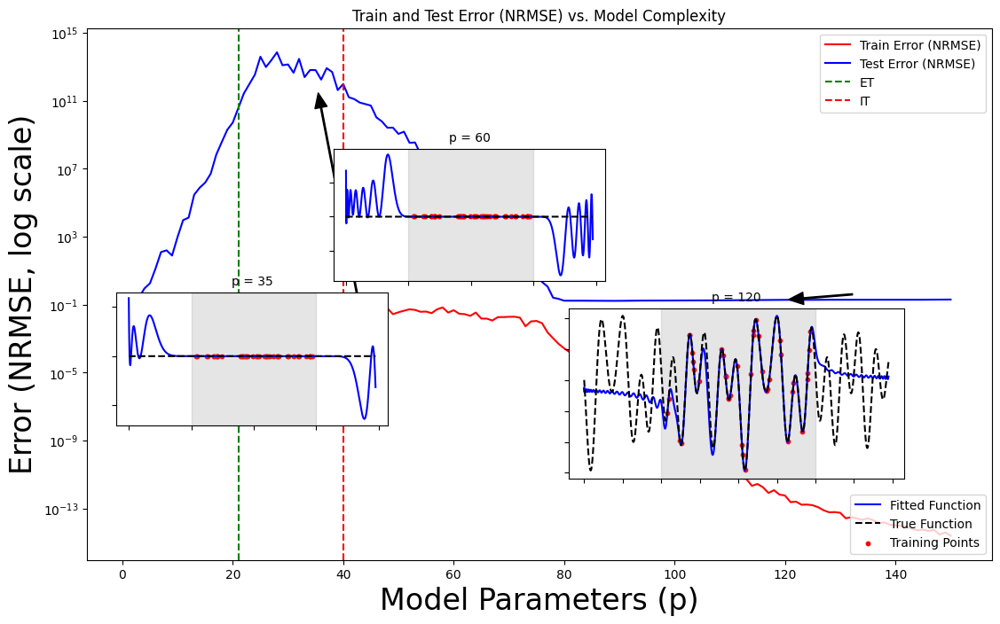

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
fig, ax = plt.subplots(figsize=(12, 8))

# ---- Main Plot ----
line1, = ax.plot(range(1, d_model_max + 1), train_nrmse_errors, label='Train Error (NRMSE)', color='red')
line2, = ax.plot(range(1, d_model_max + 1), test_nrmse_errors, label='Test Error (NRMSE)', color='blue')
line3 = ax.axvline(x=d_true, color='green', linestyle='--', label='ET')
line4 = ax.axvline(x=n, color='red', linestyle='--', label='IT')
ax.set_yscale('log')
ax.set_xlabel("Model Parameters (p)",fontsize=24)
ax.set_ylabel("Error (NRMSE, log scale)",fontsize=24)
ax.set_title("Train and Test Error (NRMSE) vs. Model Complexity")

# Create the first legend for the main plot
first_legend = ax.legend(handles=[line1, line2, line3, line4], loc='upper right')

# Add the first legend back to the axes
ax.add_artist(first_legend)


# ---- Inset Plot for p=35 ----
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

inset3 = inset_axes(ax, width="30%", height="25%", loc='upper right',
                    bbox_to_anchor=(-0.64, -0.45, 1, 1), bbox_transform=ax.transAxes, borderpad=2)
inset3_line1, = inset3.plot(x_test, design_matrix(x_test, 35, train_basis_type) @
            np.linalg.pinv(design_matrix(x_train, 35, train_basis_type)) @ y_train, label='Fitted Function', color='blue')
inset3_line2, = inset3.plot(x_true, y_true, '--', label='True Function', color='black')
inset3_scatter = inset3.scatter(x_train, y_train, color='red', label='Training Points', s=10)
plt.axvspan(in_low, in_high, color='gray', alpha=0.2, label=f'Training interval [{in_low}, {in_high}]')
inset3.set_title("p = 35", fontsize=10)
inset3.set_xticklabels([])  # Remove x-axis tick labels
inset3.set_yticklabels([])  # Remove y-axis tick labels


# ---- Inset Plot for p=60 ----
inset4 = inset_axes(ax, width="30%", height="25%", loc='upper right',
                    bbox_to_anchor=(-0.4, -0.18, 1, 1), bbox_transform=ax.transAxes, borderpad=2)
inset4.plot(x_test, design_matrix(x_test, 60, train_basis_type) @
            np.linalg.pinv(design_matrix(x_train, 60, train_basis_type)) @ y_train, label='Fitted Function', color='blue')
inset4.plot(x_true, y_true, '--', label='True Function', color='black')
plt.axvspan(in_low, in_high, color='gray', alpha=0.2, label=f'Training interval [{in_low}, {in_high}]')
inset4.scatter(x_train, y_train, color='red', label='Training Points', s=10)
inset4.set_title("p = 60", fontsize=10)
inset4.set_xticklabels([])  # Remove x-axis tick labels
inset4.set_yticklabels([])  # Remove y-axis tick labels


# ---- Inset Plot for p=120 ----
inset4 = inset_axes(ax, width="37%", height="32%", loc='upper right',
                    bbox_to_anchor=(-0.07, -0.480, 1, 1), bbox_transform=ax.transAxes, borderpad=2)
inset4.plot(x_test, design_matrix(x_test, 120, train_basis_type) @
            np.linalg.pinv(design_matrix(x_train, 120, train_basis_type)) @ y_train, label='Fitted Function', color='blue')
inset4.plot(x_true, y_true, '--', label='True Function', color='black')
inset4.scatter(x_train, y_train, color='red', label='Training Points', s=10)
plt.axvspan(in_low, in_high, color='gray', alpha=0.2, label=f'Training interval [{in_low}, {in_high}]')
inset4.set_title("p = 120", fontsize=10)
inset4.set_xticklabels([])  # Remove x-axis tick labels
inset4.set_yticklabels([])  # Remove y-axis tick labels



# Create the second legend for the inset plots
second_legend = ax.legend(handles=[inset3_line1, inset3_line2, inset3_scatter], loc='lower right')


# ---- Annotate Arrows ----
ax.annotate("", xy=(35, test_nrmse_errors[35]), xytext=(0.31, 0.40), textcoords='axes fraction',
            arrowprops=dict(facecolor='black', shrink=0.05, width=1, headwidth=10),
            horizontalalignment='left', verticalalignment='bottom')

ax.annotate("", xy=(60, test_nrmse_errors[60]), xytext=(0.45, 0.75), textcoords='axes fraction',
            arrowprops=dict(facecolor='black', shrink=0.05, width=1, headwidth=10),
            horizontalalignment='right', verticalalignment='top')

ax.annotate("", xy=(120, test_nrmse_errors[120]), xytext=(0.85, 0.5), textcoords='axes fraction',
            arrowprops=dict(facecolor='black', shrink=0.05, width=1, headwidth=10),
            horizontalalignment='right', verticalalignment='top')


# ---- Avoid Tight Layout ----
# DO NOT use plt.tight_layout()
fig.subplots_adjust(top=0.85, bottom=0.1, left=0.1, right=0.95)
plt.savefig("sg2plot.pdf")

plt.show()

from google.colab import files
files.download("sg2plot.pdf")

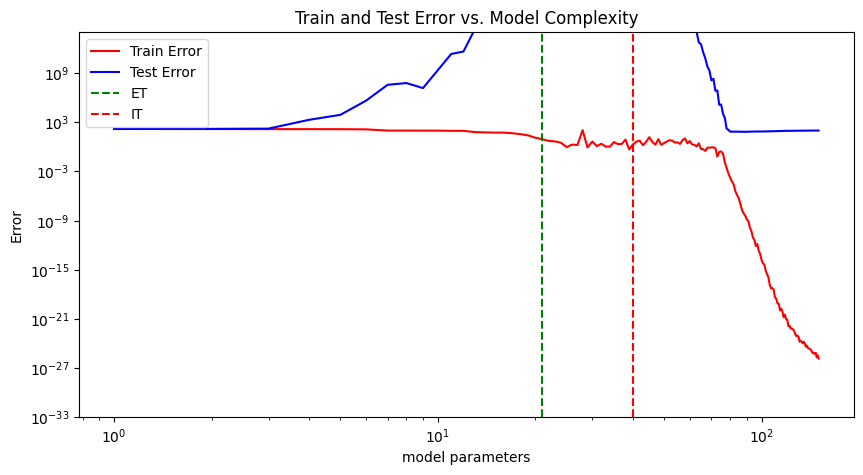

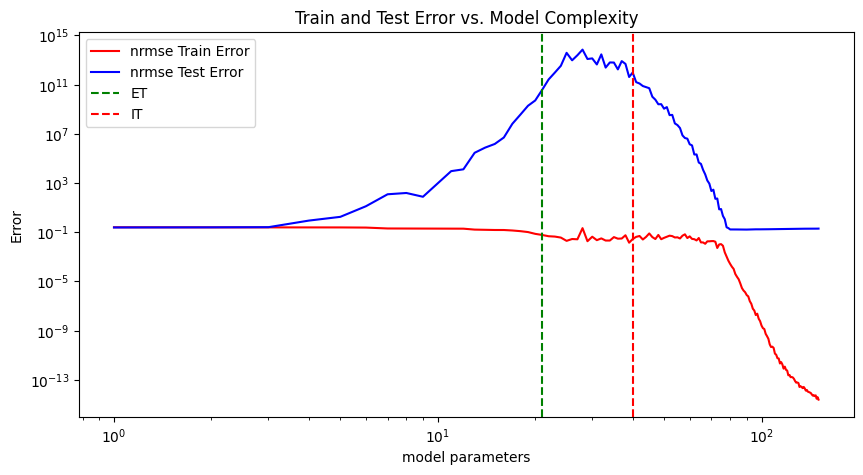

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# Plot errors
plt.figure(figsize=(10, 5))
plt.plot(range(1, d_model_max + 1), train_errors, label='Train Error', color='red')
plt.plot(range(1, d_model_max + 1), test_errors, label='Test Error', color='blue')
plt.ylim(1e-33, 1e14)
plt.xscale('log')
plt.yscale('log')
plt.axvline(x=d_true, color='green', linestyle='--', label='ET')
plt.axvline(x=n, color='red', linestyle='--', label='IT')
plt.xlabel("model parameters")
plt.ylabel("Error")
plt.legend()
plt.title("Train and Test Error vs. Model Complexity")
plt.show()

#Plot NRMSE
plt.figure(figsize=(10, 5))
plt.plot(range(1, d_model_max + 1), train_nrmse_errors, label='nrmse Train Error', color='red')
plt.plot(range(1, d_model_max + 1), test_nrmse_errors, label='nrmse Test Error', color='blue')
plt.xscale('log')
plt.yscale('log')
plt.axvline(x=d_true, color='green', linestyle='--', label='ET')
plt.axvline(x=n, color='red', linestyle='--', label='IT')
plt.xlabel("model parameters")
plt.ylabel("Error")
plt.legend()
plt.title("Train and Test Error vs. Model Complexity")
plt.show()



150
21
150


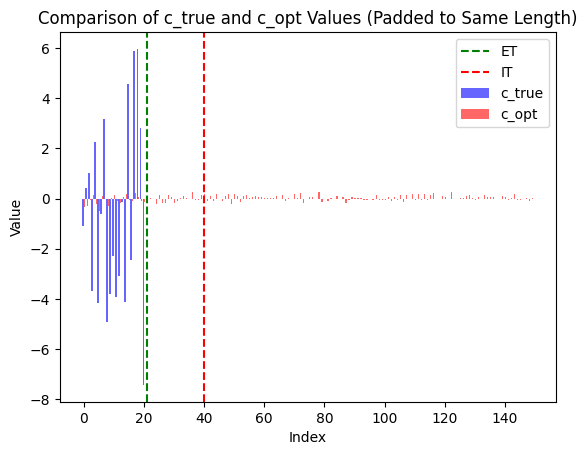

In [ ]:
# Find the maximum length
max_len = max(len(c_true), len(c_opt))
print(max_len)
print(len(c_true))
print(len(c_opt))

# Pad the shorter array with zeros
c_true_padded = np.pad(c_true, (0, max_len - len(c_true)), mode='constant')
c_opt_padded = np.pad(c_opt, (0, max_len - len(c_opt)), mode='constant')

# X-axis positions
indices = np.arange(max_len)

# Plot bars
width = 0.4  # Bar width
plt.bar(indices - width/2, c_true_padded, width, label='c_true', color='blue', alpha=0.6)
plt.bar(indices + width/2, c_opt_padded, width, label='c_opt', color='red', alpha=0.6)

# Labels and title
plt.xlabel('Index')
plt.ylabel('Value')
plt.axvline(x=d_true, color='green', linestyle='--', label='ET')
plt.axvline(x=n, color='red', linestyle='--', label='IT')
plt.title('Comparison of c_true and c_opt Values (Padded to Same Length)')
plt.legend()

# Show plot
plt.show()

